In [1]:
import shapely
import geopandas as gpd
import pandas as pd
import numpy as np
import plotly
import contextily as cx
import json
import shapely
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.lines as lines

In [2]:
proj_json_str = open("../data/reconnect_subscribers/reconnect_project_areas_20230309.json", "r").read()
proj_json = json.loads(proj_json_str)
proj_df = pd.DataFrame.from_dict(proj_json)
proj_df['geometry'] = proj_df.apply(lambda row: shapely.geometry.shape(row['geometry']), axis=1)

In [3]:
proj_df

,Project ID,geometry
0,AL1701-A59,"MULTIPOLYGON (((-88.1159 34.6605, -88.1158 34...."
1,GA1703-A61,"MULTIPOLYGON (((-81.3757 31.405, -81.3757 31.4..."
2,IA1701-A61,"MULTIPOLYGON (((-96.3818 42.9034, -96.3826 42...."
3,IA1705-A61,"MULTIPOLYGON (((-95.0145 42.0355, -95.0051 42...."
4,MO1701-A60,"MULTIPOLYGON (((-93.5615 40.0758, -93.5622 40...."
5,MT1703-A61,"MULTIPOLYGON (((-113.0077 45.1484, -113.0077 4..."
6,ND1702-A59,"MULTIPOLYGON (((-97.6191 47.6721, -97.6026 47...."
7,TN1706-A61,"MULTIPOLYGON (((-86.019 36.3215, -86.0246 36.3..."


In [4]:
proj_df['area'] = proj_df.apply(lambda row: row['geometry'].area, axis=1)
proj_df.sort_values(by='area', ascending=False, inplace=True)

In [5]:
proj_gdf = gpd.GeoDataFrame(proj_df.head(1), geometry=proj_df.geometry)
proj_gdf = proj_gdf.set_crs("EPSG:4326")

In [6]:
cx.providers

{'OpenStreetMap': {'Mapnik': {'url': 'https://tile.openstreetmap.org/{z}/{x}/{y}.png',
   'max_zoom': 19,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) OpenStreetMap contributors',
   'name': 'OpenStreetMap.Mapnik'},
  'DE': {'url': 'https://{s}.tile.openstreetmap.de/{z}/{x}/{y}.png',
   'max_zoom': 18,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) OpenStreetMap contributors',
   'name': 'OpenStreetMap.DE'},
  'CH': {'url': 'https://tile.osm.ch/switzerland/{z}/{x}/{y}.png',
   'max_zoom': 18,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) OpenStreetMap contributors',
   'bounds': [[45, 5], [48, 11]],
   'name': 'OpenStreetMap.CH'},
  'France': {'url': 'https://{s}.tile.openstreetmap.fr/osmfr/{z}/{x}/{y}.png',
   'max_zoom': 20,
   'html_attribution': '&copy; OpenStreetMap France | &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) OpenStreetMap France | (C) OpenStreetMap contributors',
   'name': 'OpenStreetMap.France'},
  'HOT': {'url': 'https://{s}.tile.openstreetmap.fr/hot/{z}/{x}/{y}.png',
   'max_zoom': 19,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors, Tiles style by <a href="https://www.hotosm.org/" target="_blank">Humanitarian OpenStreetMap Team</a> hosted by <a href="https://openstreetmap.fr/" target="_blank">OpenStreetMap France</a>',
   'attribution': '(C) OpenStreetMap contributors, Tiles style by Humanitarian OpenStreetMap Team hosted by OpenStreetMap France',
   'name': 'OpenStreetMap.HOT'},
  'BZH': {'url': 'https://tile.openstreetmap.bzh/br/{z}/{x}/{y}.png',
   'max_zoom': 19,
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors, Tiles courtesy of <a href="http://www.openstreetmap.bzh/" target="_blank">Breton OpenStreetMap Team</a>',
   'attribution': '(C) OpenStreetMap contributors, Tiles courtesy of Breton OpenStreetMap Team',
   'bounds': [[46.2, -5.5], [50, 0.7]],
   'name': 'OpenStreetMap.BZH'},
  'BlackAndWhite': {'url': 'http://{s}.tiles.wmflabs.org/bw-mapnik/{z}/{x}/{y}.png',
   'max_zoom': 18,
   'attribution': '(C) OpenStreetMap contributors',
   'html_attribution': '&copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'name': 'OpenStreetMap.BlackAndWhite'}},
 'MapTilesAPI': {'OSMEnglish': {'url': 'https://maptiles.p.rapidapi.com/{variant}/{z}/{x}/{y}.png?rapidapi-key={apikey}',
   'html_attribution': '&copy; <a href="http://www.maptilesapi.com/">MapTiles API</a>, &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) MapTiles API, (C) OpenStreetMap contributors',
   'variant': 'en/map/v1',
   'apikey': '<insert your api key here>',
   'max_zoom': 19,
   'name': 'MapTilesAPI.OSMEnglish'},
  'OSMFrancais': {'url': 'https://maptiles.p.rapidapi.com/{variant}/{z}/{x}/{y}.png?rapidapi-key={apikey}',
   'html_attribution': '&copy; <a href="http://www.maptilesapi.com/">MapTiles API</a>, &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) MapTiles API, (C) OpenStreetMap contributors',
   'variant': 'fr/map/v1',
   'apikey': '<insert your api key here>',
   'max_zoom': 19,
   'name': 'MapTilesAPI.OSMFrancais'},
  'OSMEspagnol': {'url': 'https://maptiles.p.rapidapi.com/{variant}/{z}/{x}/{y}.png?rapidapi-key={apikey}',
   'html_attribution': '&copy; <a href="http://www.maptilesapi.com/">MapTiles API</a>, &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors',
   'attribution': '(C) MapTiles API, (C) OpenStreetMap contributors',
   'variant': 'es/map/v1',
   'apikey': '<ins

0
1
2
3
4
5


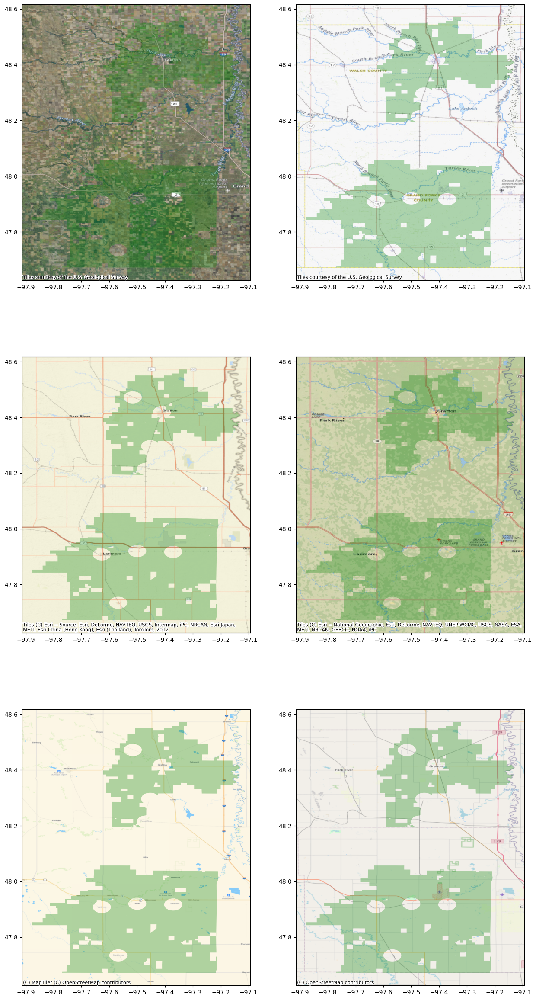

In [7]:
nrow, ncol = 3, 2
fig, axes = plt.subplots(nrow, ncol, figsize = (15, 30))

sources = [cx.providers.USGS.USImageryTopo, cx.providers.USGS.USTopo, cx.providers.Esri.WorldStreetMap, cx.providers.Esri.NatGeoWorldMap,
           cx.providers.MapTiler.Streets(key = "uPMhUPYKeNu6jZ3h79wL"), cx.providers.OpenStreetMap.Mapnik]

for i in range(nrow):
    for j in range(ncol):
        print(str(i*ncol + j))
        proj_gdf.plot(ax = axes[i][j], color = "green", alpha=0.3)
        cx.add_basemap(axes[i][j], crs=proj_gdf.crs.to_string(), source = sources[i*ncol + j])

In [7]:
subscr_df = pd.read_excel("../data/reconnect_subscribers/ReConnect_Project_Construction_Status.xlsx", sheet_name="Geocoded Subscribers")
subscr_df

,Entity Name,Program,Project ID,R&C Report: Report Name,Report Name,Period Start Date,Period End Date,Report Status,Subscriber Type,Price,...,Download Speed Type,Upload Speed,Upload Speed Type,Address,City,State,Zipcode,Latitude,Longitude,Notes
0,"National Telephone of Alabama, Inc.",ReConnect,AL1701-A59,RPT-1200,Annual Performance Report,1/1/2021,12/31/2021,Submitted,Residence,54.95,...,Mbps,250.0,Mbps,2330 WHITE PIKE,CHEROKEE,AL,35616.0,34.62374301376934,-88.02511502431014,NaN
1,"National Telephone of Alabama, Inc.",ReConnect,AL1701-A59,RPT-1200,Annual Performance Report,1/1/2021,12/31/2021,Submitted,Residence,79.95,...,Mbps,940.0,Mbps,2505 WHITE PKE APT B,CHEROKEE,AL,35616.0,34.62462801701605,-88.0251479651896,NaN
2,"National Telephone of Alabama, Inc.",ReConnect,AL1701-A59,RPT-1200,Annual Performance Report,1/1/2021,12/31/2021,Submitted,Residence,54.95,...,Mbps,250.0,Mbps,4760 MAUD RD,CHEROKEE,AL,35616.0,34.62745200592434,-88.0688040182315,NaN
3,"National Telephone of Alabama, Inc.",ReConnect,AL1701-A59,RPT-1200,Annual Performance Report,1/1/2021,12/31/2021,Submitted,Residence,54.95,...,Mbps,250.0,Mbps,4630 MAUD RD,CHEROKEE,AL,35616.0,34.62828399363366,-88.07018200311353,NaN
4,"National Telephone of Alabama, Inc.",ReConnect,AL1701-A59,RPT-1200,Annual Performance Report,1/1/2021,12/31/2021,Submitted,Residence,79.95,...,Mbps,940.0,Mbps,4625 MAUD RD,CHEROKEE,AL,35616.0,34.629362996029386,-88.07024998034831,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4131,"Mon-Cre Telephone Cooperative, Incorporated",ReConnect,AL1705-A65,RPT-1954,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,267.06,...,Mbps,200.0,Mbps,NaN,NaN,NaN,NaN,32.1890649,-86.24551002,NaN
4132,"Mon-Cre Telephone Cooperative, Incorporated",ReConnect,AL1705-A65,RPT-1954,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,267.06,...,Mbps,200.0,Mbps,NaN,NaN,NaN,NaN,32.19754708,-86.24230636,NaN
4133,"Mon-Cre Telephone Cooperative, Incorporated",ReConnect,AL1705-A65,RPT-1954,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,267.06,...,Mbps,200.0,Mbps,NaN,NaN,NaN,NaN,32.20302368,-86.23578665,NaN
4134,"Mon-Cre Telephone Cooperative, Incorporated",ReConnect,AL1705-A65,RPT-1954,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,267.06,...,Mbps,200.0,Mbps,NaN,NaN,NaN,NaN,32.20146784,-86.24775582,NaN


In [8]:
bk_df = pd.read_csv("../data/BLACKKNIGHT_ANALYSIS_SUBSET.csv", low_memory=False, index_col=0)
bk_df

,fips_code,pid,apn,duplicateapn,property_address_source_flag,property_full_street_address,property_city_name,property_state,property_zip_code,property_zip4,...,raw_mailing_zip4,edition,owner1_first_name,owner1_middle_name,owner1_last_name,owner2_firstname,owner2_middle_name,owner2_last_name,parsed_owner_source_code,dpid
1,19193,16584,884705119003,NaN,C,1810 S LAKEPORT ST,SIOUX CITY,IA,51106.0,4908.0,...,NaN,14,LINDA,KAY,RIESENBERG,NaN,NaN,NaN,3,191930016537
2,19193,16585,884705119004,NaN,C,1814 S LAKEPORT ST,SIOUX CITY,IA,51106.0,4908.0,...,NaN,14,NATHAN M,NaN,BROCKHAUS,NaN,NaN,NaN,1,191930016538
3,19193,16586,884705119005,NaN,C,1818 S LAKEPORT ST,SIOUX CITY,IA,51106.0,4908.0,...,NaN,14,JARED,NaN,RAYMER,JOHN,NaN,RAYMER,1,191930016539
4,19193,16587,884705119006,NaN,NaN,1822 S LAKEPORT ST,SIOUX CITY,IA,51106.0,4908.0,...,NaN,14,SOFIA,NaN,TARELO,ROBERTO,SOFIA,TARELO-GALLEGOS,3,191930016540
5,19193,16555,884705117021,NaN,C,1915 S CLINTON ST,SIOUX CITY,IA,51106.0,2515.0,...,NaN,14,DAWN,A,LADE,NaN,NaN,NaN,3,191930016505
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
516268,19193,15821,884629426018,NaN,NaN,14 W 1ST ST,BRONSON,IA,51007.0,7722.0,...,NaN,14,JAMES,D,AMICK,KRISTIE,L,AMICK,3,191930015788
516269,19193,15822,884629427001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,14,NaN,NaN,HAAFKE CHARLES & PEGGY TRUST,NaN,NaN,NaN,3,191930015789
516270,19193,15823,884629427003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,14,NaN,NaN,HAAFKE CHARLES & PEGGY TRUST,NaN,NaN,NaN,3,191930015790
516271,19193,15824,884629428002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,142.0,14,NaN,NaN,CITY OF BRONSON,NaN,NaN,NaN,3,191930015791


In [10]:
proj_gdf

,Project ID,geometry,area
6,ND1702-A59,"MULTIPOLYGON (((-97.61910 47.67210, -97.60260 ...",0.261334


In [11]:
proj_subscr_df = subscr_df[subscr_df['Project ID'] == proj_gdf['Project ID'].iloc[0]]
proj_subscr_gdf = gpd.GeoDataFrame(proj_subscr_df, geometry = gpd.points_from_xy(proj_subscr_df['Longitude'], proj_subscr_df['Latitude']), crs=proj_gdf.crs)
proj_subscr_gdf

,Entity Name,Program,Project ID,R&C Report: Report Name,Report Name,Period Start Date,Period End Date,Report Status,Subscriber Type,Price,...,Upload Speed,Upload Speed Type,Address,City,State,Zipcode,Latitude,Longitude,Notes,geometry
2756,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,57.95,...,50.0,Mbps,1805 Rylee Rd NE,Larimore,ND,58251.0,47.923430,-97.667280,NaN,POINT (-97.66728 47.92343)
2757,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,56.50,...,50.0,Mbps,1813 Rylee Rd NE,Larimore,ND,58251.0,47.923430,-97.667280,NaN,POINT (-97.66728 47.92343)
2758,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,57.95,...,50.0,Mbps,1819 Rylee Rd NE,Larimore,ND,58251.0,47.923430,-97.667280,NaN,POINT (-97.66728 47.92343)
2759,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,147.95,...,500.0,Mbps,3550 US 2,Larimore,ND,58251.0,47.923430,-97.667280,NaN,POINT (-97.66728 47.92343)
2760,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,57.95,...,50.0,Mbps,3552 US 2,Larimore,ND,58251.0,47.923430,-97.667280,NaN,POINT (-97.66728 47.92343)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3224,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,57.95,...,50.0,Mbps,15207 77th St NE,Grafton,ND,58237.0,48.528158,-97.363528,NaN,POINT (-97.36353 48.52816)
3225,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,77.95,...,100.0,Mbps,7707 146th Ave NE,Grafton,ND,58237.0,48.529400,-97.491270,NaN,POINT (-97.49127 48.52940)
3226,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,76.50,...,100.0,Mbps,7727 Highway 81,Grafton,ND,58237.0,48.532501,-97.451804,NaN,POINT (-97.45180 48.53250)
3227,Polar Communications Mutual Aid Corporation,ReConnect,ND1702-A59,RPT-0686,Construction Progress Report,1/1/2021,12/31/2021,Submitted,Residence,67.95,...,100.0,Mbps,14806 78th St NE,Grafton,ND,58237.0,48.542280,-97.446315,NaN,POINT (-97.44631 48.54228)


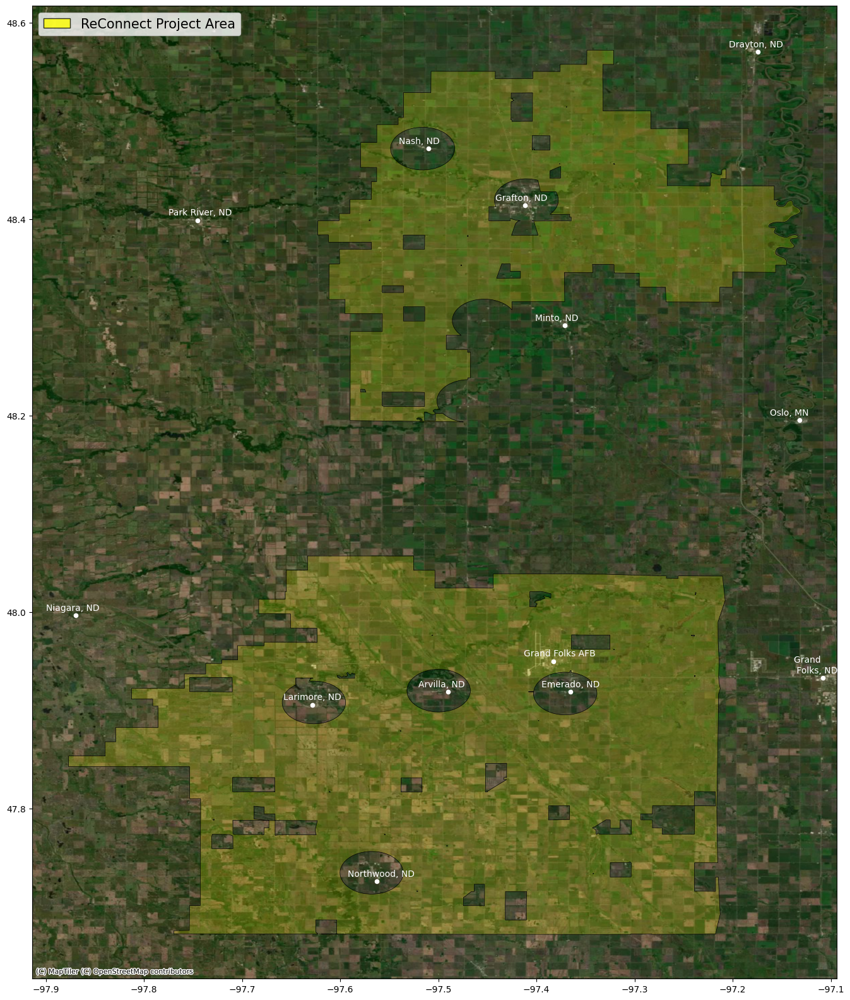

In [12]:
ax = proj_gdf.boundary.plot(color = "black", alpha=1, figsize = (20,20), linewidth=0.5)
proj_gdf.plot(ax = ax, color = "yellow", alpha=0.2, figsize = (20,20))
cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.MapTiler.Satellite(key = "uPMhUPYKeNu6jZ3h79wL"))

patch_list =[patches.Patch(facecolor = 'yellow', alpha=.8, linewidth = 1, edgecolor='black', label = "ReConnect Project Area")]

ax.legend(handles=patch_list, fontsize=15, loc='upper left',
        bbox_to_anchor = (0,1), title_fontsize=15)

# add cities to map
cities_coors_dict = {  # default pairing is long, lat
    "Emerado, ND": (-97.36516833063409, 47.91874223073824),
    "Grand \n Folks, ND": (-97.10801030056025, 47.93319425568195),
    "Grand Folks AFB": (-97.38281192957376, 47.94995749964084),
    "Grafton, ND": (-97.41167702804967, 48.41397762644782),
    "Arvilla, ND": (-97.49018766846939, 47.91865252338325),
    "Larimore, ND": (-97.62801895498659,47.905580623063585),
    "Northwood, ND": (-97.56260236626932, 47.725923018125926), 
    "Nash, ND": (-97.51000531501198, 48.47153391335596),
    "Drayton, ND": (-97.17420902950074, 48.570329900537274),
    "Oslo, MN": (-97.13213383761611, 48.195299806577054),
    "Petersburg, ND": (-97.9999226664267, 48.011162825800724),
    "Niagara, ND": (-97.86940720309234, 47.99663325215164),
    "Park River, ND": (-97.74507989043126, 48.39878633622124),
    "Minto, ND": (-97.37134823610366, 48.291727792708656)
}

for label, coor in cities_coors_dict.items():
    ax.scatter(coor[0], coor[1], marker = 'o', s=20, color='white')
    ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='white')

In [13]:
proj_nearby_bk_df = bk_df[(bk_df.property_address_latitiude > 47.6) & (bk_df.property_address_latitiude < 48.6) & (bk_df.property_address_longitude > -97.9) & (bk_df.property_address_longitude < -97.1)]
proj_nearby_bk_gdf = gpd.GeoDataFrame(proj_nearby_bk_df, geometry=gpd.points_from_xy(proj_nearby_bk_df.property_address_longitude, proj_nearby_bk_df.property_address_latitiude), crs=proj_gdf.crs)
proj_nearby_bk_gdf

,fips_code,pid,apn,duplicateapn,property_address_source_flag,property_full_street_address,property_city_name,property_state,property_zip_code,property_zip4,...,edition,owner1_first_name,owner1_middle_name,owner1_last_name,owner2_firstname,owner2_middle_name,owner2_last_name,parsed_owner_source_code,dpid,geometry
11114,38035,12249,42000100021000,NaN,NaN,109 BROWELL ST,EMERADO,ND,58228.0,4036.0,...,21,JOEL F,NaN,LINNEMAN,NaN,NaN,NaN,1,380350012275,POINT (-97.37129 47.91776)
11649,38035,12250,42000100022000,NaN,NaN,NaN,EMERADO,ND,58228.0,NaN,...,21,STEPHEN,A,PFEIFF,BONNIE,M,PFEIFF,3,380350012276,POINT (-97.37019 47.91801)
11889,38035,12352,42160400009000,NaN,NaN,300 6TH ST,EMERADO,ND,58228.0,4103.0,...,21,SAMUEL,B,VERNER,JEAN,M,VERNER,3,380350012379,POINT (-97.36265 47.92870)
12227,38035,12353,42160400010000,NaN,NaN,302 6TH ST,EMERADO,ND,58228.0,4103.0,...,21,RANDY,A,SKOLD,NaN,NaN,NaN,3,380350012380,POINT (-97.36266 47.92847)
72992,38091,467,02 0000 00394 000,NaN,NaN,NaN,NaN,NaN,58240.0,NaN,...,9,DANIEL,S,FLATEN,NaN,NaN,NaN,3,380910000451,POINT (-97.66479 47.62378)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
490461,38035,9522,32590100006000,NaN,NaN,NaN,NaN,NaN,58228.0,NaN,...,21,GORDON,NaN,LINNELL,GERALDINE,NaN,LINNELL,1,380350009526,POINT (-97.33106 47.84679)
495569,38035,9776,33360400001000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,21,SHAWN A,NaN,MONTGOMERY,KRISTA J,NaN,MONTGOMERY,2,380350009777,POINT (-97.37929 47.78501)
495585,38035,9777,33360400002000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,21,ALFRED,NaN,FIEBIGER,CHRISSY,NaN,FIEBIGER,3,380350009778,POINT (-97.37929 47.78501)
495636,38035,9778,33360400004000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,21,SHAWN A,NaN,MONTGOMERY,KRISTA J,NaN,MONTGOMERY,2,380350009779,POINT (-97.37929 47.78501)


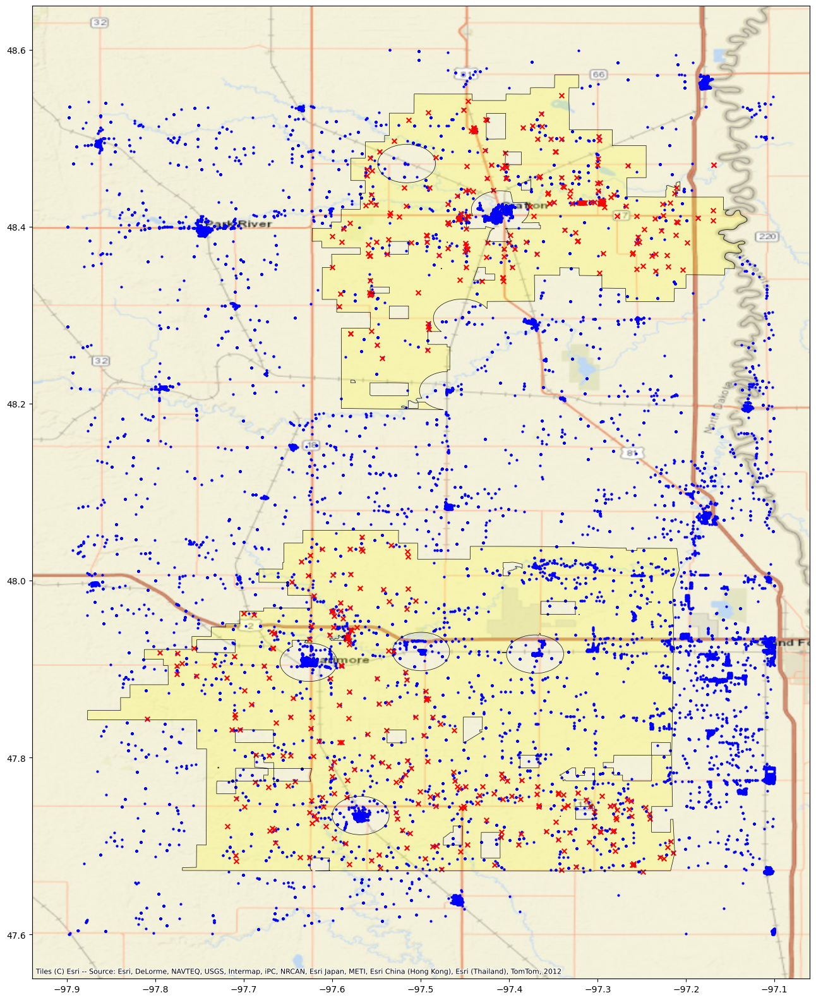

In [14]:
ax = proj_gdf.plot(color = "yellow", alpha=0.2, figsize = (20,20))
proj_gdf.boundary.plot(ax=ax, color='black', alpha=1, linewidth=0.5)
proj_nearby_bk_gdf.plot(ax = ax, color = 'blue', markersize=4)
proj_subscr_gdf.plot(ax = ax, color = 'red', markersize=30, marker='x')
cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.Esri.WorldStreetMap)

## Generate buffer zone of exterior only

<Axes: >

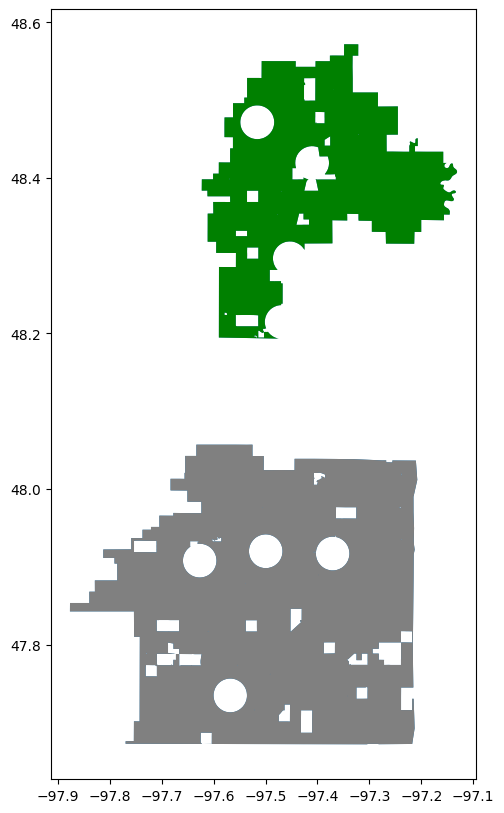

In [15]:
ax = proj_gdf.plot(figsize=(10,10))
proj_mult = proj_gdf['geometry'].iloc[0]
proj_polys = gpd.GeoSeries([pol for pol in proj_mult.geoms], crs = proj_gdf.crs)
proj_polys.plot(ax = ax, color=['grey', 'green'])

<Axes: >

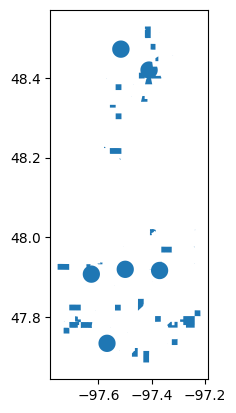

In [16]:
interior_rings = proj_polys.interiors.sum()  # a collection of linear rings as 'holes' in the data
fillings = [shapely.geometry.Polygon(ring) for ring in interior_rings] #if shapely.geometry.Polygon(ring).area < sizelim]
fill_poly = gpd.GeoSeries(fillings, crs = proj_gdf.crs)
fill_poly.plot()

<Axes: >

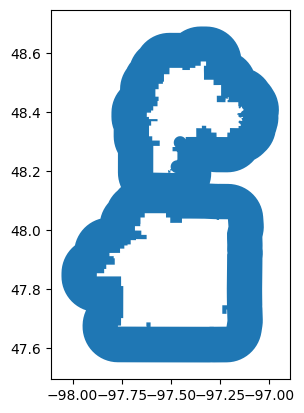

In [17]:
proj_filled_mult = shapely.ops.unary_union([proj_mult.buffer(0), fill_poly.unary_union.buffer(0)])  # buffer 0 here to fix invalid geometry that can cause TopologyException
proj_filled_mult = gpd.GeoSeries([proj_filled_mult], crs = proj_gdf.crs)
proj_buffer_only = proj_filled_mult.to_crs("EPSG:3857").buffer(20000).to_crs(proj_gdf.crs).symmetric_difference(proj_filled_mult)  # 20 km is roughly 13 miles
proj_buffer_only.plot()

In [18]:
proj_nearby_bk_df = bk_df[(bk_df.property_address_latitiude > 47.45) & (bk_df.property_address_latitiude < 48.7) & (bk_df.property_address_longitude > -98.1) & (bk_df.property_address_longitude < -96.9)]
proj_nearby_bk_gdf = gpd.GeoDataFrame(proj_nearby_bk_df, geometry=gpd.points_from_xy(proj_nearby_bk_df.property_address_longitude, proj_nearby_bk_df.property_address_latitiude), crs=proj_gdf.crs)

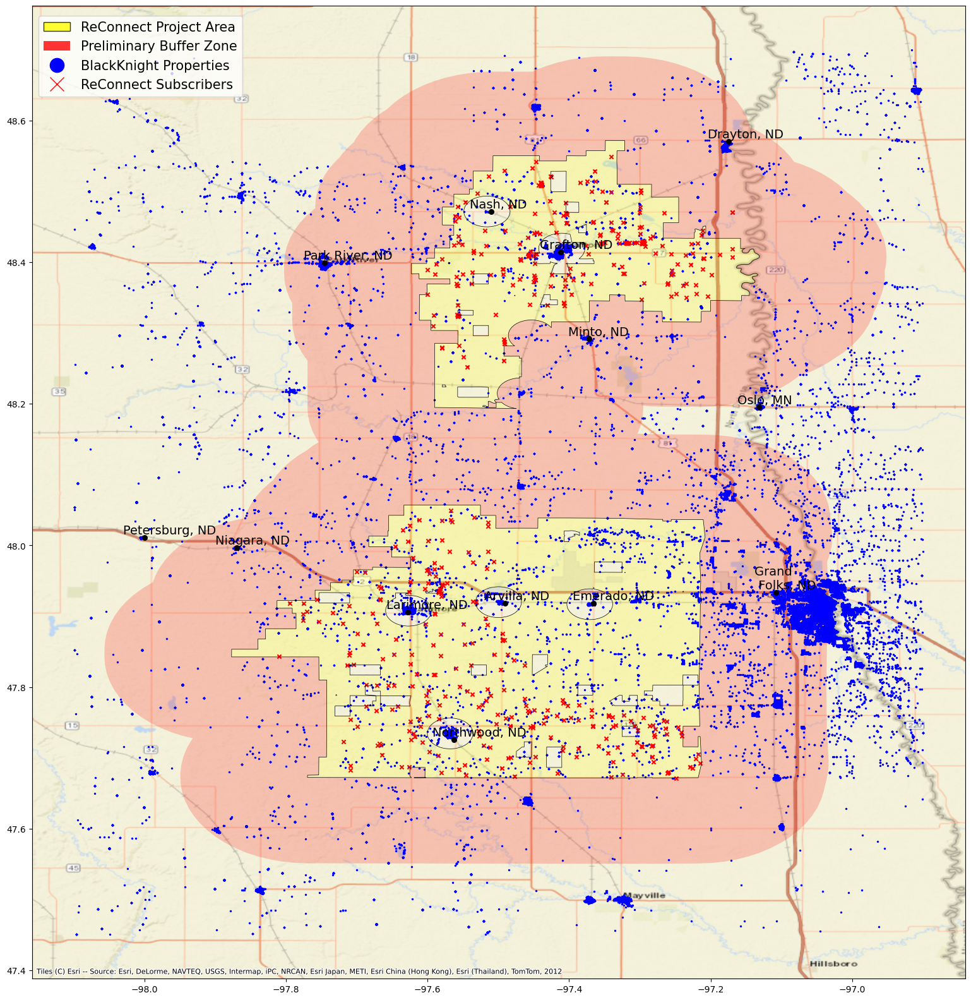

In [19]:
ax = proj_buffer_only.plot(color='red', alpha=0.2, figsize = (20,20))
proj_gdf.plot(ax = ax, color = "yellow", alpha=0.2)
proj_gdf.boundary.plot(ax = ax, color='black', linewidth=0.5)
proj_nearby_bk_gdf.plot(ax = ax, color = 'blue', markersize=2)
proj_subscr_gdf.plot(ax = ax, color = 'red', markersize=20, marker='x', label="ReConnect Subscribers")
cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.Esri.WorldStreetMap)

patch_list =[patches.Patch(facecolor = 'yellow', alpha=.8, linewidth = 1, edgecolor='black', label = "ReConnect Project Area"),
            patches.Patch(facecolor = 'red', alpha=.8, linewidth = 0, edgecolor = 'white', label = "Preliminary Buffer Zone"),
            lines.Line2D([0], [0], color = "blue", marker='o', markersize=16, lw=0, label="BlackKnight Properties"),
            lines.Line2D([0], [0], color = "red", marker='x', markersize=16, lw=0, label="ReConnect Subscribers"),]


ax.legend(handles=patch_list, fontsize=15, loc='lower left',
        bbox_to_anchor = (0,0.9), title_fontsize=15)

# add cities to map
cities_coors_dict = {  # default pairing is long, lat
    "Emerado, ND": (-97.36516833063409, 47.91874223073824),
    "Grand \n Folks, ND": (-97.10801030056025, 47.93319425568195),
    "Grafton, ND": (-97.41167702804967, 48.41397762644782),
    "Arvilla, ND": (-97.49018766846939, 47.91865252338325),
    "Larimore, ND": (-97.62801895498659,47.905580623063585),
    "Northwood, ND": (-97.56260236626932, 47.725923018125926), 
    "Nash, ND": (-97.51000531501198, 48.47153391335596),
    "Drayton, ND": (-97.17420902950074, 48.570329900537274),
    "Oslo, MN": (-97.13213383761611, 48.195299806577054),
    "Petersburg, ND": (-97.9999226664267, 48.011162825800724),
    "Niagara, ND": (-97.86940720309234, 47.99663325215164),
    "Park River, ND": (-97.74507989043126, 48.39878633622124),
    "Minto, ND": (-97.37134823610366, 48.291727792708656)
}

for label, coor in cities_coors_dict.items():
    ax.scatter(coor[0], coor[1], marker = 'o', s=30, color='black')
    ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='black', fontsize=14)

## Standardize plots
Ensure that all plots are the same size by plotting every data source and adjusting the alpha

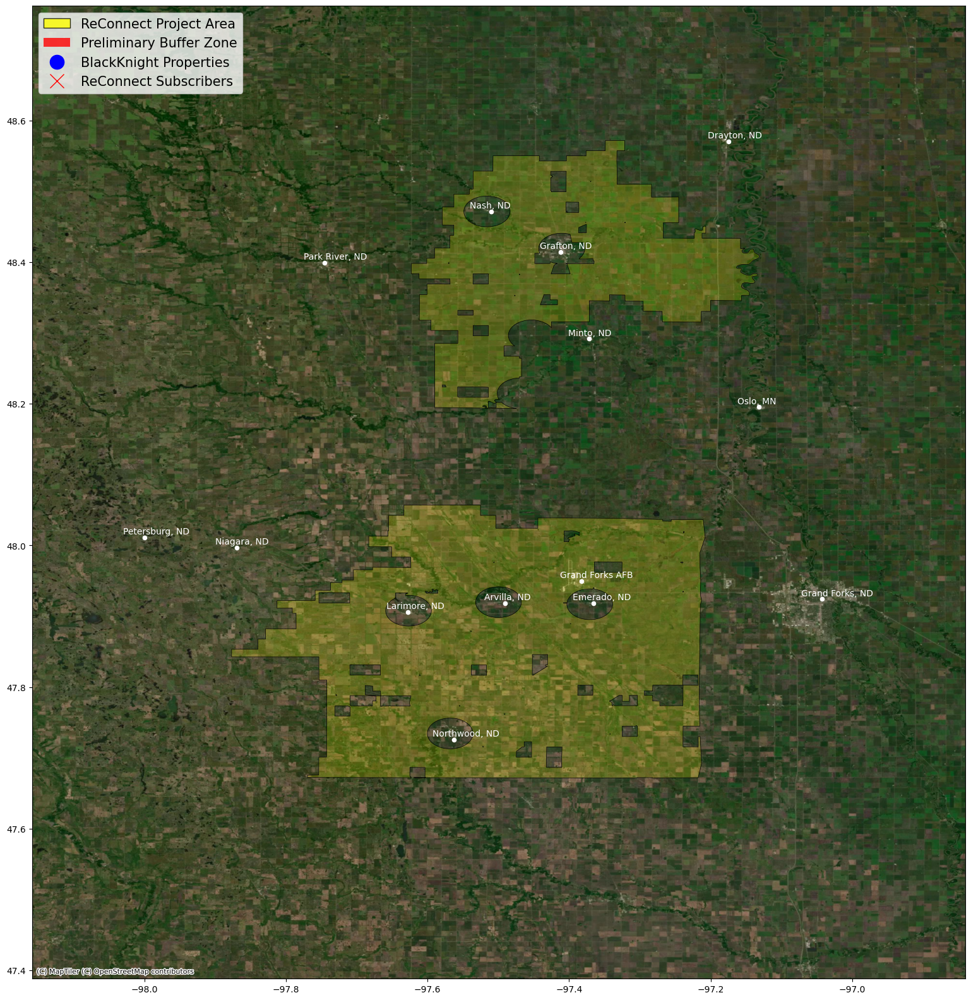

In [20]:
ax = proj_gdf.plot(color = "yellow", alpha=0.2, figsize = (20,20))
proj_gdf.boundary.plot(ax = ax, color = 'black', linewidth=0.5, alpha = 1)

proj_subscr_gdf.plot(ax = ax, color = 'red', markersize=20, marker='x', alpha = 0)
proj_nearby_bk_gdf.plot(ax = ax, color = 'blue', markersize=2, alpha = 0)
proj_buffer_only.plot(ax = ax, color = 'red', alpha = 0)

# cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.Esri.WorldStreetMap)
cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.MapTiler.Satellite(key = "uPMhUPYKeNu6jZ3h79wL"))

# add cities to map
cities_coors_dict = {  # default pairing is long, lat
    "Emerado, ND": (-97.36516833063409, 47.91874223073824),
    "Grand Forks, ND": (-97.04243314562945, 47.92413693363131),
    "Grand Forks AFB": (-97.38281192957376, 47.94995749964084),
    "Grafton, ND": (-97.41167702804967, 48.41397762644782),
    "Arvilla, ND": (-97.49018766846939, 47.91865252338325),
    "Larimore, ND": (-97.62801895498659,47.905580623063585),
    "Northwood, ND": (-97.56260236626932, 47.725923018125926), 
    "Nash, ND": (-97.51000531501198, 48.47153391335596),
    "Drayton, ND": (-97.17420902950074, 48.570329900537274),
    "Oslo, MN": (-97.13213383761611, 48.195299806577054),
    "Petersburg, ND": (-97.9999226664267, 48.011162825800724),
    "Niagara, ND": (-97.86940720309234, 47.99663325215164),
    "Park River, ND": (-97.74507989043126, 48.39878633622124),
    "Minto, ND": (-97.37134823610366, 48.291727792708656)
}

for label, coor in cities_coors_dict.items():
    ax.scatter(coor[0], coor[1], marker = 'o', s=20, color='white')
    ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='white')
#     ax.scatter(coor[0], coor[1], marker = 'o', s=30, color='black')
#     ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='black', fontsize=14)
    


patch_list =[patches.Patch(facecolor = 'yellow', alpha=.8, linewidth = 1, edgecolor='black', label = "ReConnect Project Area"),
            patches.Patch(facecolor = 'red', alpha=.8, linewidth = 0, edgecolor = 'white', label = "Preliminary Buffer Zone"),
            lines.Line2D([0], [0], color = "blue", marker='o', markersize=16, lw=0, label="BlackKnight Properties"),
            lines.Line2D([0], [0], color = "red", marker='x', markersize=16, lw=0, label="ReConnect Subscribers"),]


ax.legend(handles=patch_list, fontsize=15, loc='upper left',
        bbox_to_anchor = (0,1), title_fontsize=15)

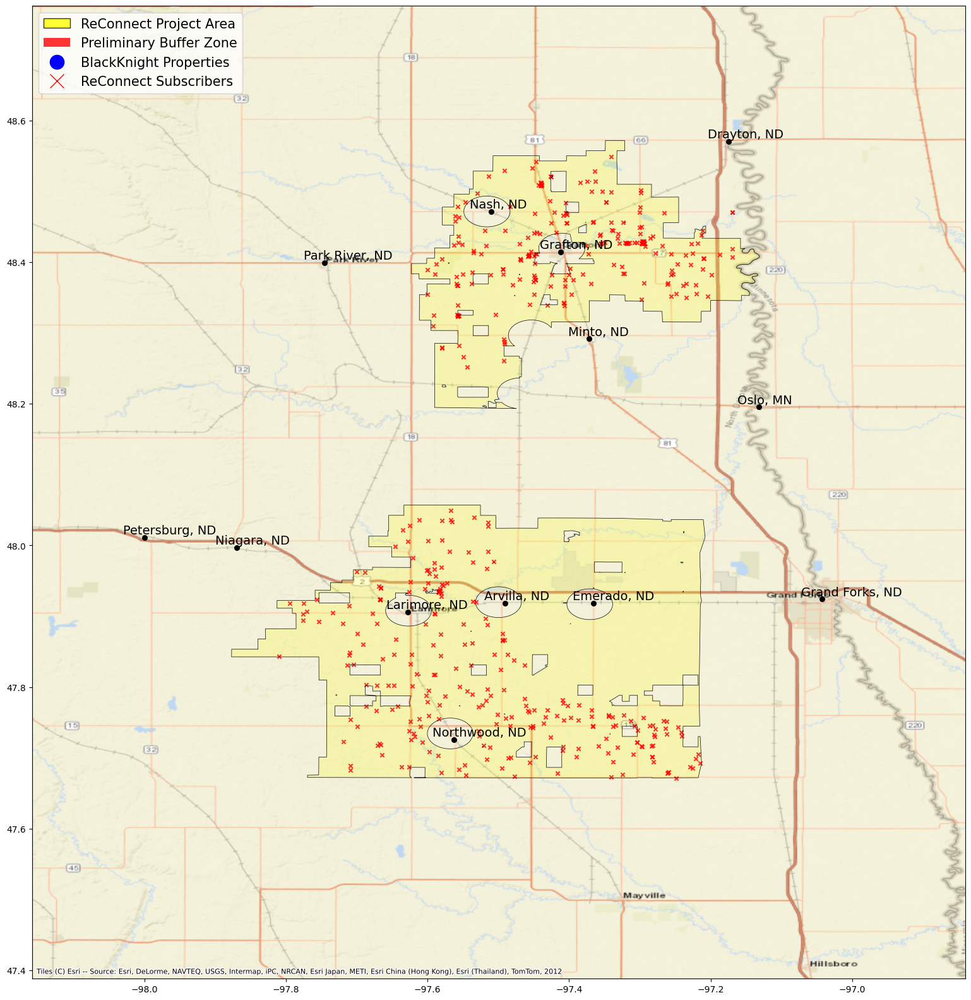

In [21]:
ax = proj_gdf.plot(color = "yellow", alpha=0.2, figsize = (20,20))
proj_gdf.boundary.plot(ax = ax, color = 'black', linewidth=0.5, alpha = 1)

proj_subscr_gdf.plot(ax = ax, color = 'red', markersize=20, marker='x', alpha = 0.8)
proj_nearby_bk_gdf.plot(ax = ax, color = 'blue', markersize=2, alpha = 0)
proj_buffer_only.plot(ax = ax, color = 'red', alpha = 0)

cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.Esri.WorldStreetMap)
# cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.MapTiler.Satellite(key = "uPMhUPYKeNu6jZ3h79wL"))

# add cities to map
cities_coors_dict = {  # default pairing is long, lat
    "Emerado, ND": (-97.36516833063409, 47.91874223073824),
    "Grand Forks, ND": (-97.04243314562945, 47.92413693363131),
#     "Grand Forks AFB": (-97.38281192957376, 47.94995749964084),
    "Grafton, ND": (-97.41167702804967, 48.41397762644782),
    "Arvilla, ND": (-97.49018766846939, 47.91865252338325),
    "Larimore, ND": (-97.62801895498659,47.905580623063585),
    "Northwood, ND": (-97.56260236626932, 47.725923018125926), 
    "Nash, ND": (-97.51000531501198, 48.47153391335596),
    "Drayton, ND": (-97.17420902950074, 48.570329900537274),
    "Oslo, MN": (-97.13213383761611, 48.195299806577054),
    "Petersburg, ND": (-97.9999226664267, 48.011162825800724),
    "Niagara, ND": (-97.86940720309234, 47.99663325215164),
    "Park River, ND": (-97.74507989043126, 48.39878633622124),
    "Minto, ND": (-97.37134823610366, 48.291727792708656)
}

for label, coor in cities_coors_dict.items():
#     ax.scatter(coor[0], coor[1], marker = 'o', s=20, color='white')
#     ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='white')
    ax.scatter(coor[0], coor[1], marker = 'o', s=30, color='black')
    ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='black', fontsize=14)


patch_list =[patches.Patch(facecolor = 'yellow', alpha=.8, linewidth = 1, edgecolor='black', label = "ReConnect Project Area"),
            patches.Patch(facecolor = 'red', alpha=.8, linewidth = 0, edgecolor = 'white', label = "Preliminary Buffer Zone"),
            lines.Line2D([0], [0], color = "blue", marker='o', markersize=16, lw=0, label="BlackKnight Properties"),
            lines.Line2D([0], [0], color = "red", marker='x', markersize=16, lw=0, label="ReConnect Subscribers"),]


ax.legend(handles=patch_list, fontsize=15, loc='upper left',
        bbox_to_anchor = (0,1), title_fontsize=15)

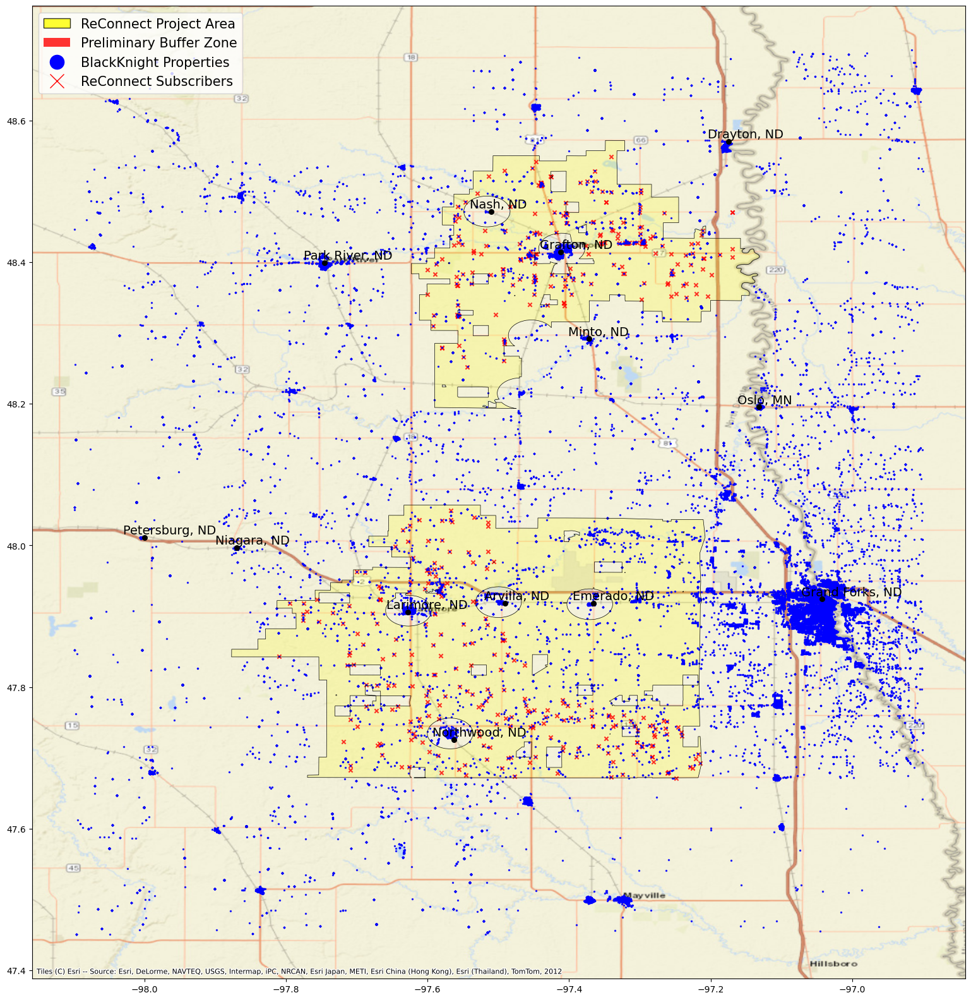

In [22]:
ax = proj_gdf.plot(color = "yellow", alpha=0.2, figsize = (20,20))
proj_gdf.boundary.plot(ax = ax, color = 'black', linewidth=0.5, alpha = 1)

proj_subscr_gdf.plot(ax = ax, color = 'red', markersize=20, marker='x', alpha = 0.8)
proj_nearby_bk_gdf.plot(ax = ax, color = 'blue', markersize=2, alpha = 0.8)
proj_buffer_only.plot(ax = ax, color = 'red', alpha = 0)

cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.Esri.WorldStreetMap)
# cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.MapTiler.Satellite(key = "uPMhUPYKeNu6jZ3h79wL"))

# add cities to map
cities_coors_dict = {  # default pairing is long, lat
    "Emerado, ND": (-97.36516833063409, 47.91874223073824),
    "Grand Forks, ND": (-97.04243314562945, 47.92413693363131),
#     "Grand Forks AFB": (-97.38281192957376, 47.94995749964084),
    "Grafton, ND": (-97.41167702804967, 48.41397762644782),
    "Arvilla, ND": (-97.49018766846939, 47.91865252338325),
    "Larimore, ND": (-97.62801895498659,47.905580623063585),
    "Northwood, ND": (-97.56260236626932, 47.725923018125926), 
    "Nash, ND": (-97.51000531501198, 48.47153391335596),
    "Drayton, ND": (-97.17420902950074, 48.570329900537274),
    "Oslo, MN": (-97.13213383761611, 48.195299806577054),
    "Petersburg, ND": (-97.9999226664267, 48.011162825800724),
    "Niagara, ND": (-97.86940720309234, 47.99663325215164),
    "Park River, ND": (-97.74507989043126, 48.39878633622124),
    "Minto, ND": (-97.37134823610366, 48.291727792708656)
}

for label, coor in cities_coors_dict.items():
#     ax.scatter(coor[0], coor[1], marker = 'o', s=20, color='white')
#     ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='white')
    ax.scatter(coor[0], coor[1], marker = 'o', s=30, color='black')
    ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='black', fontsize=14)


patch_list =[patches.Patch(facecolor = 'yellow', alpha=.8, linewidth = 1, edgecolor='black', label = "ReConnect Project Area"),
            patches.Patch(facecolor = 'red', alpha=.8, linewidth = 0, edgecolor = 'white', label = "Preliminary Buffer Zone"),
            lines.Line2D([0], [0], color = "blue", marker='o', markersize=16, lw=0, label="BlackKnight Properties"),
            lines.Line2D([0], [0], color = "red", marker='x', markersize=16, lw=0, label="ReConnect Subscribers"),]


ax.legend(handles=patch_list, fontsize=15, loc='upper left',
        bbox_to_anchor = (0,1), title_fontsize=15)

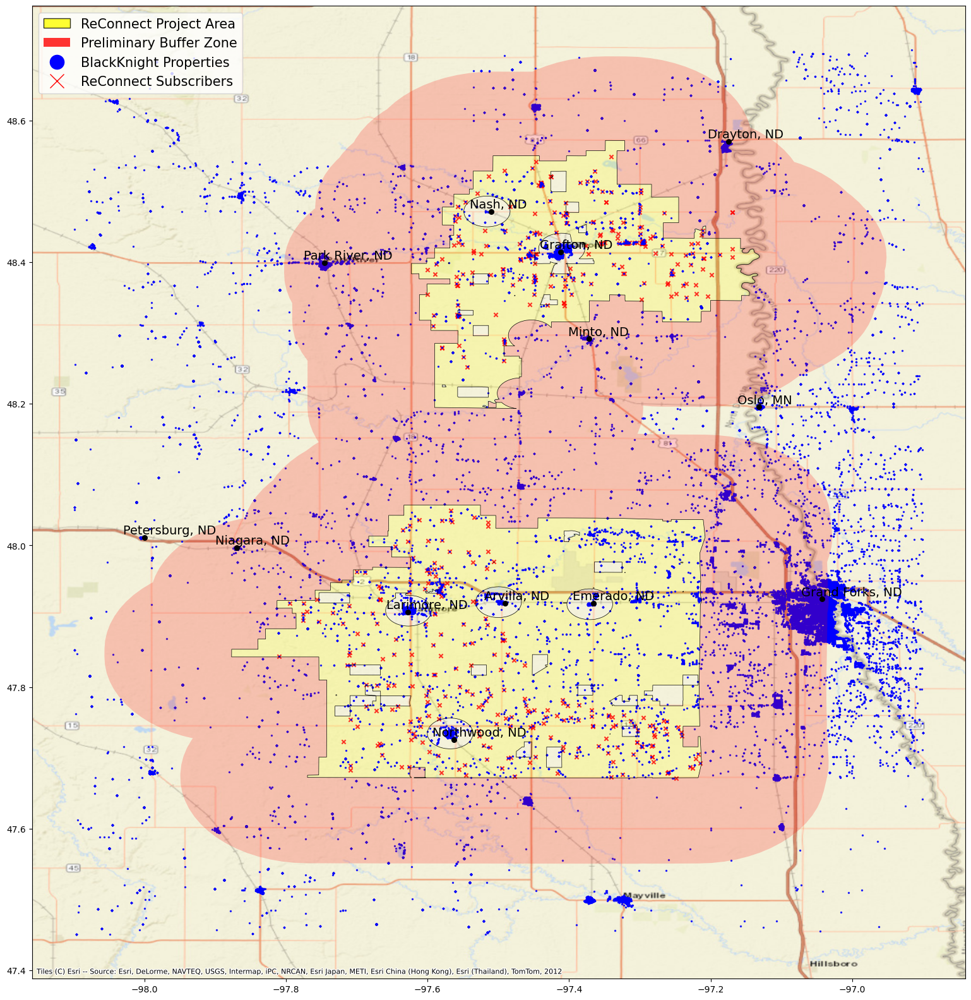

In [23]:
ax = proj_gdf.plot(color = "yellow", alpha=0.2, figsize = (20,20))
proj_gdf.boundary.plot(ax = ax, color = 'black', linewidth=0.5, alpha = 1)

proj_subscr_gdf.plot(ax = ax, color = 'red', markersize=20, marker='x', alpha = 0.8)
proj_nearby_bk_gdf.plot(ax = ax, color = 'blue', markersize=2, alpha = 0.8)
proj_buffer_only.plot(ax = ax, color = 'red', alpha = 0.2)

cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.Esri.WorldStreetMap)
# cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.MapTiler.Satellite(key = "uPMhUPYKeNu6jZ3h79wL"))

# add cities to map
cities_coors_dict = {  # default pairing is long, lat
    "Emerado, ND": (-97.36516833063409, 47.91874223073824),
    "Grand Forks, ND": (-97.04243314562945, 47.92413693363131),
#     "Grand Forks AFB": (-97.38281192957376, 47.94995749964084),
    "Grafton, ND": (-97.41167702804967, 48.41397762644782),
    "Arvilla, ND": (-97.49018766846939, 47.91865252338325),
    "Larimore, ND": (-97.62801895498659,47.905580623063585),
    "Northwood, ND": (-97.56260236626932, 47.725923018125926), 
    "Nash, ND": (-97.51000531501198, 48.47153391335596),
    "Drayton, ND": (-97.17420902950074, 48.570329900537274),
    "Oslo, MN": (-97.13213383761611, 48.195299806577054),
    "Petersburg, ND": (-97.9999226664267, 48.011162825800724),
    "Niagara, ND": (-97.86940720309234, 47.99663325215164),
    "Park River, ND": (-97.74507989043126, 48.39878633622124),
    "Minto, ND": (-97.37134823610366, 48.291727792708656)
}

for label, coor in cities_coors_dict.items():
#     ax.scatter(coor[0], coor[1], marker = 'o', s=20, color='white')
#     ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='white')
    ax.scatter(coor[0], coor[1], marker = 'o', s=30, color='black')
    ax.annotate(text = label, xy = (coor[0] - 0.03, coor[1] + 0.005), color='black', fontsize=14)


patch_list =[patches.Patch(facecolor = 'yellow', alpha=.8, linewidth = 1, edgecolor='black', label = "ReConnect Project Area"),
            patches.Patch(facecolor = 'red', alpha=.8, linewidth = 0, edgecolor = 'white', label = "Preliminary Buffer Zone"),
            lines.Line2D([0], [0], color = "blue", marker='o', markersize=16, lw=0, label="BlackKnight Properties"),
            lines.Line2D([0], [0], color = "red", marker='x', markersize=16, lw=0, label="ReConnect Subscribers"),]


ax.legend(handles=patch_list, fontsize=15, loc='upper left',
        bbox_to_anchor = (0,1), title_fontsize=15)

# Plot of matched subscriber data

In [24]:
df = pd.read_csv('../data/reconnect_subscribers/exact_address_match.csv')
df

,Unnamed: 0,index_subscr,dpid_bk,match_type,fips_bk,apn_bk,address_bk,city_bk,state_bk,zipcode_bk,latitude_bk,longitude_bk,address_subscr,city_subscr,state_subscr,zipcode_subscr,latitude_subscr,longitude_subscr
0,0,818,191490016465,exact address match,19149,15-24-400-014,25572 HIGHWAY 12,WESTFIELD,IA,51062.0,42.685234,-96.567019,25572 Highway 12,Westfield,IA,51062.0,42.688900,-96.571960
1,1,819,191490016844,exact address match,19149,16-19-300-003,25754 HIGHWAY 12,WESTFIELD,IA,51062.0,42.684184,-96.562879,25754 Highway 12,Westfield,IA,51062.0,42.688900,-96.571960
2,2,820,191490005880,exact address match,19149,08-35-400-005,21601 N RIDGE RD,WESTFIELD,IA,51062.0,42.742312,-96.588421,21601 N Ridge Rd,Westfield,IA,51062.0,42.717720,-96.524160
3,3,821,191490016671,exact address match,19149,16-11-200-001,23079 K18N,WESTFIELD,IA,51062.0,42.719780,-96.476048,23079 K18n,Westfield,IA,51062.0,42.717720,-96.524160
4,4,822,191490016673,exact address match,19149,16-11-200-003,23345 K18N,WESTFIELD,IA,51062.0,42.716212,-96.476020,23345 K18n,Westfield,IA,51062.0,42.717720,-96.524160
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
672,672,3218,380990002358,exact address match,38099,08000001970010,7590 151ST AVE NE,GRAFTON,ND,58237.0,48.512412,-97.384728,7590 151st Ave NE,Grafton,ND,58237.0,48.512530,-97.384114
673,673,3219,380990002307,exact address match,38099,08000001929010,15229 76TH ST NE,GRAFTON,ND,58237.0,48.514368,-97.358834,15229 76th St NE,Grafton,ND,58237.0,48.513970,-97.362770
674,674,3220,380990002299,exact address match,38099,08000001924010,15149 76TH ST NE,GRAFTON,ND,58237.0,48.514489,-97.374053,15149 76th St NE,Grafton,ND,58237.0,48.514241,-97.374062
675,675,3224,380990002273,exact address match,38099,08000001901000,15207 77TH ST NE,GRAFTON,ND,58237.0,48.529037,-97.363334,15207 77th St NE,Grafton,ND,58237.0,48.528158,-97.363528


In [25]:
df = df[df.state_bk == 'ND']
df

,Unnamed: 0,index_subscr,dpid_bk,match_type,fips_bk,apn_bk,address_bk,city_bk,state_bk,zipcode_bk,latitude_bk,longitude_bk,address_subscr,city_subscr,state_subscr,zipcode_subscr,latitude_subscr,longitude_subscr
351,351,2756,380350033093,exact address match,38035,11450100001000,1805 RYLEE RD NE,LARIMORE,ND,58251.0,47.933392,-97.666100,1805 Rylee Rd NE,Larimore,ND,58251.0,47.923430,-97.667280
352,352,2757,380350033094,exact address match,38035,11450100002000,1813 RYLEE RD NE,LARIMORE,ND,58251.0,47.930900,-97.680100,1813 Rylee Rd NE,Larimore,ND,58251.0,47.923430,-97.667280
353,353,2759,380350006100,exact address match,38035,18290400005002,3550 US 2,LARIMORE,ND,58251.0,47.948020,-97.588768,3550 US 2,Larimore,ND,58251.0,47.923430,-97.667280
354,354,2760,380350006094,exact address match,38035,18290300002000,3552 US 2,LARIMORE,ND,58251.0,47.948020,-97.592553,3552 US 2,Larimore,ND,58251.0,47.923430,-97.667280
355,355,2761,380350006095,exact address match,38035,18290300003000,3566 US 2,LARIMORE,ND,58251.0,47.948017,-97.594462,3566 US 2,Larimore,ND,58251.0,47.923430,-97.667280
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
672,672,3218,380990002358,exact address match,38099,08000001970010,7590 151ST AVE NE,GRAFTON,ND,58237.0,48.512412,-97.384728,7590 151st Ave NE,Grafton,ND,58237.0,48.512530,-97.384114
673,673,3219,380990002307,exact address match,38099,08000001929010,15229 76TH ST NE,GRAFTON,ND,58237.0,48.514368,-97.358834,15229 76th St NE,Grafton,ND,58237.0,48.513970,-97.362770
674,674,3220,380990002299,exact address match,38099,08000001924010,15149 76TH ST NE,GRAFTON,ND,58237.0,48.514489,-97.374053,15149 76th St NE,Grafton,ND,58237.0,48.514241,-97.374062
675,675,3224,380990002273,exact address match,38099,08000001901000,15207 77TH ST NE,GRAFTON,ND,58237.0,48.529037,-97.363334,15207 77th St NE,Grafton,ND,58237.0,48.528158,-97.363528


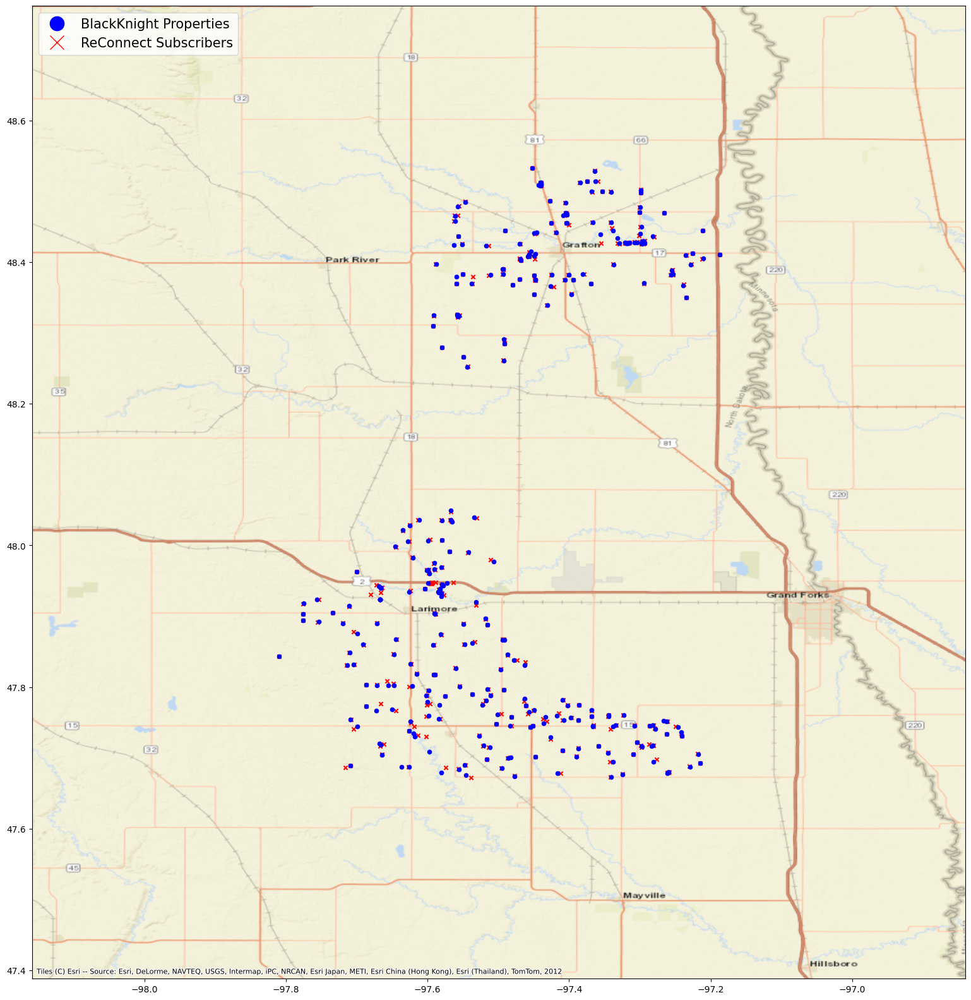

In [26]:
ax = gpd.GeoSeries(gpd.points_from_xy(df.longitude_bk, df.latitude_bk, crs=proj_gdf.crs)).plot(color = 'red', markersize=20, marker='x', figsize = (20, 20))
gpd.GeoSeries(gpd.points_from_xy(df.longitude_subscr, df.latitude_subscr, crs=proj_gdf.crs)).plot(ax = ax, color = 'blue', markersize=20, marker='o')

proj_nearby_bk_gdf.plot(ax = ax, color = 'blue', markersize=2, alpha = 0)
cx.add_basemap(ax, crs=proj_gdf.crs.to_string(), source = cx.providers.Esri.WorldStreetMap)

patch_list =[lines.Line2D([0], [0], color = "blue", marker='o', markersize=16, lw=0, label="BlackKnight Properties"),
            lines.Line2D([0], [0], color = "red", marker='x', markersize=16, lw=0, label="ReConnect Subscribers"),]

ax.legend(handles=patch_list, fontsize=15, loc='upper left',
        bbox_to_anchor = (0,1), title_fontsize=15)

# Identify rural blocks
from table H1 from Decennial Census 2020, number of households in rural vs urban in each census block